# Script de calibration des caméra via un échiquier de 7 par 10
Calibre les caméra et sauvegarde les matrices pour corriger les images dans le recalage
## Première phase
Récupération des chemins des images (peut importe l'OS)
Il y a un tableau global rappellant toutes les caméras à calibrer
**Le nom des images doivent contenir le numéro de la caméra**
Les images sont triées pour obtenir le même résultat à chaque éxecution
On obtient à la fin un dictionnaire qui lie le nom de la caméra à c'est images d'échiquier


In [1]:
import cv2
import numpy as np
import os
import SimpleITK as sitk
import sys
import matplotlib.pyplot as plt
import glob
from joblib import Parallel, delayed
from tqdm.notebook import tqdm,trange

Cameras = ("Camera1","Camera2","Camera3","Camera4")
CheminImages=dict()

for cam in Cameras:
    regex = os.path.join("**","*"+cam+"*.bmp")
    trieCheminImage = glob.glob(regex,recursive=True)
    trieCheminImage.sort()
    CheminImages[cam]= trieCheminImage


## Deuxième phase
Detection des points clés dans l'échiquier pour une caméra et récupère la matrice de la caméra
*Utilisation de la fonction via joblib pour le traitement en parallèle et tqdm pour l'avancement*
Ensuite les matrices obtenues sont sauvegardées dans le dossier "Data" pour un usage ultérieur
**Utilisation de plusieur image**
**C'est complexe d'évaluer la qualité de la calibration**

In [2]:
def foundAndSaveCalibration(Camera: str ,CheminImages:list,corners:tuple):
   """Prend en paramètre une liste de chemin d'image
      Sauvegarde les données dans des fichiers numpy compresses
      Return un 
   """
   # termination criteria
   criteria = (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER, 50000, 0.00001)
   # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
   objp = np.zeros((np.prod(corners),3), np.float32)
   objp[:,:2] = np.indices(corners).T.reshape(-1, 2)
   # Arrays to store object points and image points from all the images.
   objpoints = [] # 3d point in real world space
   imgpoints = [] # 2d points in image plane.


   for image in CheminImages:

      img = cv2.imread(image)
      gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
      # Find the chess board corners
      ret, corners = cv2.findChessboardCorners(gray, (10,7))
      # If found, add object points, image points (after refining them)
      if ret == True:
         objpoints.append(objp)
         corners = cv2.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
         imgpoints.append(corners)
         # Draw and display the corners
         #cv2.drawChessboardCorners(img, (7,10), corners2, ret)


   """Calibration de la camera, retour de matrice"""
   ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

   cheminSauvegardeCalibration = os.path.join("Data",Camera)
   np.savez_compressed(cheminSauvegardeCalibration,mtx=mtx,dist=dist)
   return cheminSauvegardeCalibration

In [3]:
Parallel(n_jobs=4,prefer="threads")(delayed(foundAndSaveCalibration)(Cameras[i],CheminImages[Cameras[i]],(10,7))for i in tqdm(range(len(Cameras))))

  0%|          | 0/4 [00:00<?, ?it/s]

['Data/Camera1', 'Data/Camera2', 'Data/Camera3', 'Data/Camera4']

## Phase trois
Test de chargement des données
Génére un dictionnaire qui lie le nom d'une caméra à ses matrices

In [4]:
"""Chargement des données"""
cheminParam =[]
regex = os.path.join("**","*.npz")
cheminParam = glob.glob(regex,recursive=True)
cheminParam.sort()

paramCam = dict()
for cam in Cameras:
    for fichierParam in cheminParam:
        if cam in fichierParam:
            with np.load(fichierParam) as data:
                paramCam[cam] = {"mtx" : data['mtx'],"dist" : data['dist']}
print(paramCam)

{'Camera1': {'mtx': array([[2.82568740e+03, 0.00000000e+00, 1.26325100e+03],
       [0.00000000e+00, 2.82586067e+03, 9.79291096e+02],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]), 'dist': array([[-0.21907795,  0.25332612,  0.00183203, -0.00175609, -0.40434549]])}, 'Camera2': {'mtx': array([[2.16628617e+03, 0.00000000e+00, 1.28890014e+03],
       [0.00000000e+00, 2.16400327e+03, 1.03563446e+03],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]), 'dist': array([[-1.86097876e-01,  8.59697259e-01,  3.70039373e-04,
        -4.56247626e-03, -2.32672664e+00]])}, 'Camera3': {'mtx': array([[2.81720047e+03, 0.00000000e+00, 1.21782943e+03],
       [0.00000000e+00, 2.81664248e+03, 1.00075666e+03],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]), 'dist': array([[-0.18495925, -0.08103933,  0.00156822, -0.00254917,  0.64169507]])}, 'Camera4': {'mtx': array([[2.82158355e+03, 0.00000000e+00, 1.29136666e+03],
       [0.00000000e+00, 2.82303501e+03, 1.06018449e+03],
       

## Phase quatre
Utilisation des données pour corriger les images test

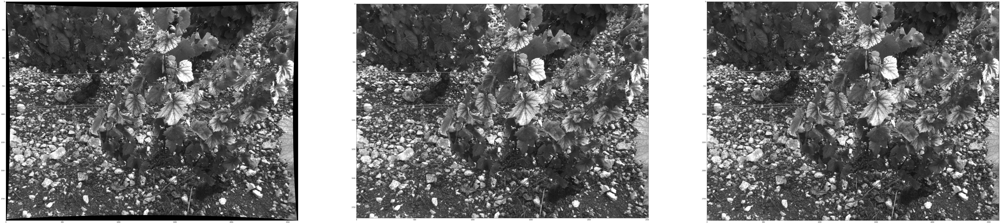

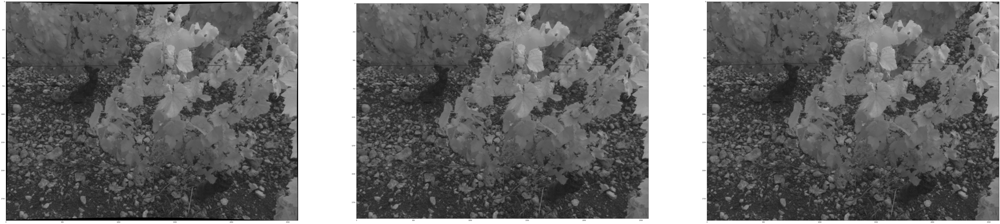

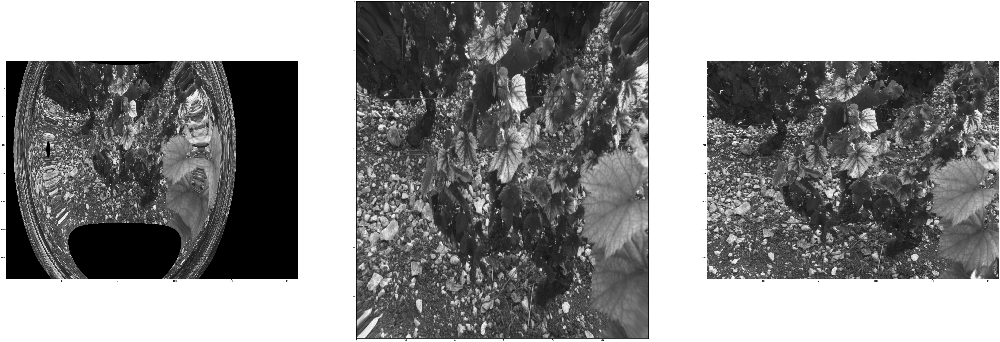

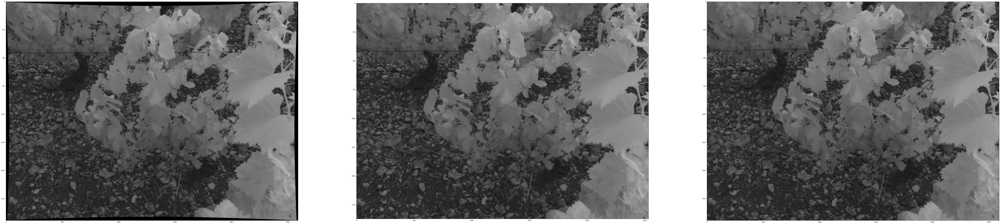

In [5]:

nomSet = os.path.join("..","DAMAV_Jeux_Image","SET3")
searchFolder = os.path.join(nomSet,"*.bmp")
imagefound = glob.glob(searchFolder)

for nomImage in imagefound:
    for cam in Cameras:
        if cam in nomImage:
            mtx = paramCam[cam]["mtx"]
            dist = paramCam[cam]["dist"]

    img = cv2.imread(nomImage)
    h,  w = img.shape[:2]
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1.0, (w,h))
    # undistort
    undistorded = cv2.undistort(img, mtx, dist, None, newcameramtx)
    # crop the image
    x, y, w, h = roi
    roiundistorded = undistorded[y:y+h, x:x+w]
    
    plt.figure(figsize=(120, 80))
    ax = plt.subplot(1, 3, 1)
    plt.imshow(undistorded)
    ax = plt.subplot(1, 3, 2)
    plt.imshow(roiundistorded)
    ax = plt.subplot(1, 3, 3)
    plt.imshow(img)

    plt.show()

    


## Fonction pour corriger une image
*Utilisable avec joblib*

In [6]:


def undistordImage(image:str,Cameras:tuple,paramCam:dict):

    for cam in Cameras:
        if cam in image:
            mtx = paramCam[cam]["mtx"]
            dist = paramCam[cam]["dist"]
            img = cv2.imread(image)
            h,  w = img.shape[:2]
            newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1.0, (w,h))
            # undistort
            undistorded = cv2.undistort(img, mtx, dist, None, newcameramtx)
            # crop the image
            x, y, w, h = roi
            roiundistorded = undistorded[y:y+h, x:x+w]
            return roiundistorded

    
